# Niche definition using spatial neighbors  
### Spatial pancreas  

### Pre-requisites

In [1]:
import seaborn as sns
import pandas as pd
import numpy as np

import scanpy as sc
import squidpy as sq

import matplotlib.pyplot as plt

#sc.settings.set_figure_params(dpi=80, facecolor="white")

### Load data

In [2]:
adata = sc.read('../../../../../../datasets/projects/20230301_Sander_SpatialPancreas_sara.jimenez/spatial/S1_annotated_l0.h5ad')
adata

/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/anndata/__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


AnnData object with n_obs × n_vars = 108711 × 979
    obs: 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.GCG', 'Max.GCG', 'Mean.CD3', 'Max.CD3', 'Mean.DAPI', 'Max.DAPI', 'cell_ID', 'condition', 'slide', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_NegPrb', 'log1p_total_counts_NegPrb', 'pct_counts_NegPrb', 'n_genes', 'cell_type_coarse'
    var: 'NegPrb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    uns: 'log1p', 'spatial'
    obsm: 'spatial', 'spatial_fov'
    layers: 'counts'

In [3]:
adata.obs['cell_type_coarse'].cat.categories

Index(['Acinar', 'Alpha', 'Beta', 'Ductal', 'Endocrine', 'Endothelial',
       'Fibroblasts', 'Immune', 'Mast'],
      dtype='object')

In [4]:
adata.uns['cell_type_coarse_colors'] = [
    '#edd892', #acinar
    '#219ebc', #alpha
    '#adc178', #beta
    '#f79824', #ductal
    '#718355', #endocrine
    '#f15156', #endothelial
    '#bbd0ff', #Fibroblasts
    '#979dac', #Immune
    '#582f0e'  #mast
]

### Data Exploration

In [5]:
adata.obs.fov.cat.categories

Index(['1', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '2',
       '20', '21', '22', '23', '24', '3', '4', '5', '6', '7', '8', '9'],
      dtype='object')

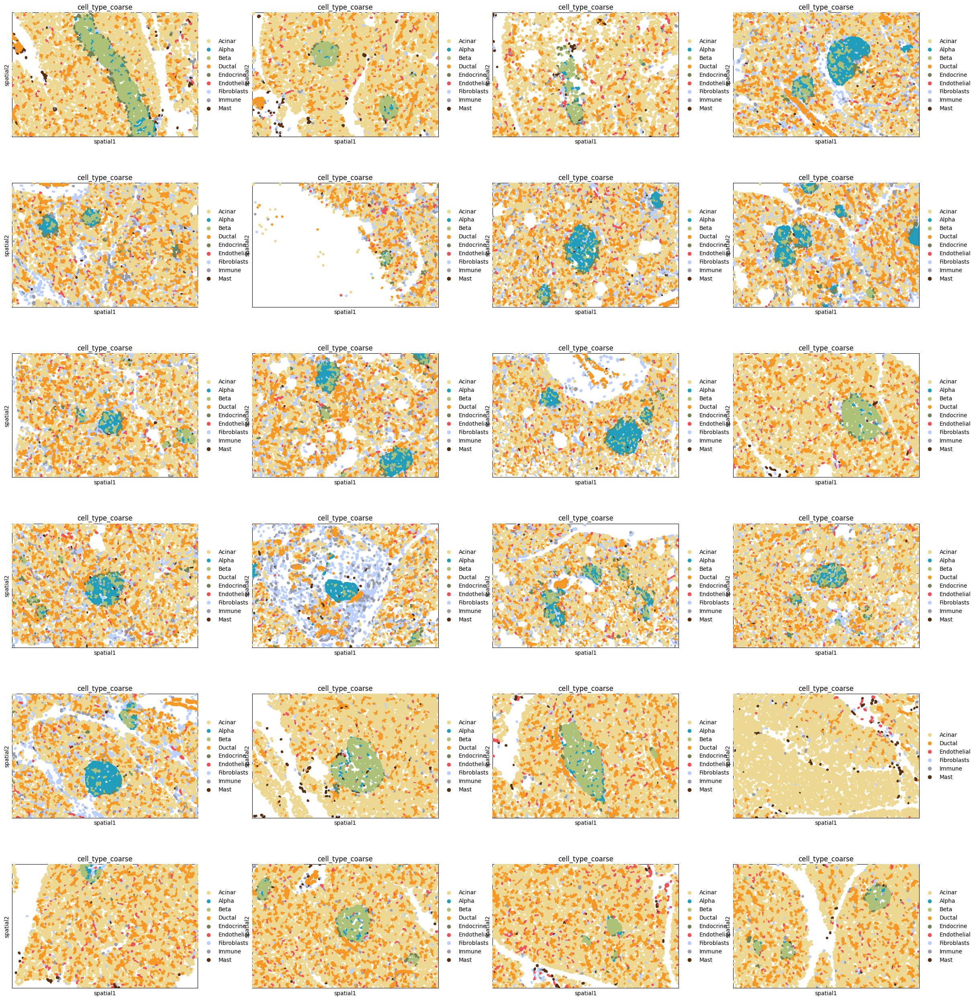

In [6]:
sq.pl.spatial_segment(adata,color='cell_type_coarse',ncols=4,#library_id=['10','12'],
                      library_key='fov', seg_cell_id='cell_ID',cmap='RdYlBu_r', img=False)

### Niche definition in terms of nearest neighbors

In [ ]:
adata.X.max()

In [ ]:
adata.layers['counts'].max()

In [6]:
# calculating node degree for several distances 
for ng in [5,15,30,50,100,200]:
    connectivities, _ = sq.gr.spatial_neighbors(
        adata, n_neighs=ng, coord_type='generic', copy=True
    )
    print(np.mean(np.sum(connectivities, axis=0)))

5.0
15.0
30.0
50.0
100.0
200.0


In [7]:
sq.gr.spatial_neighbors(
    adata,
    n_neighs=50,
    library_key='fov', # to get the spatial graphs per slide (ie per fov)
    coord_type="generic",
    delaunay=False,
    
)

In [8]:
adata.obsp["spatial_connectivities"].shape

(108711, 108711)

/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/squidpy/pl/_color_utils.py:28: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  target.uns[color_key] = source.uns[color_key]


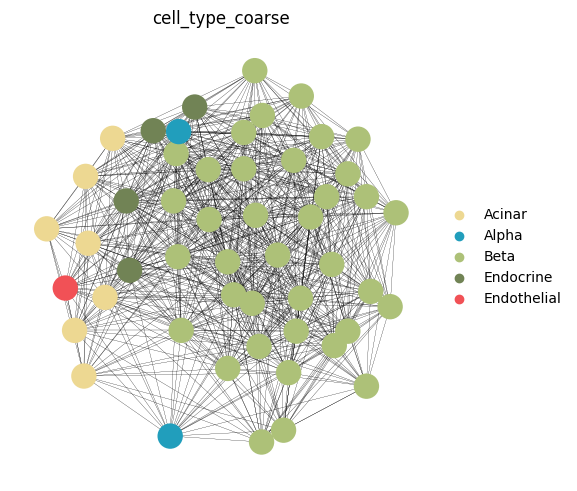

In [69]:
_, idx = adata.obsp["spatial_connectivities"][420, :].nonzero()
idx = np.append(idx, 420)
sq.pl.spatial_scatter(
    adata[idx,420],
    library_id = '12',
    color="cell_type_coarse",
    connectivity_key="spatial_connectivities",
    size=30,
    edges_width=.1,
    edges_color="black",
    img=False,
    frameon=False
)

In [10]:
import anndata as ad

In [11]:
# params
library_key = 'fov'
cell_type_key = 'cell_type_coarse'
condition_key = 'condition'

In [12]:
niche_datas = []
for f in adata.obs[library_key].unique(): 
    
    fov = adata[np.isin(adata.obs[library_key],[f])].copy()
    
    niche_data = ad.AnnData(X = np.zeros((len(fov.obs_names),len(fov.obs[cell_type_key].unique()))),
                            obs = pd.DataFrame(index=fov.obs_names),
                            var = pd.DataFrame(index=fov.obs[cell_type_key].unique()))

    niche_data.obs['obs_names'] = fov.obs_names
    niche_data.var['var_names'] = fov.obs[cell_type_key].unique()
    niche_data.obs[library_key] = str(f)
    niche_data.obs[condition_key] = fov.obs[condition_key]

    for c in range(len(fov.obs_names)):
        _, idx = fov.obsp["spatial_connectivities"][c, :].nonzero()
        idx = np.append(idx, c)
        cts = fov[idx,].obs[cell_type_key]
        
        for i in cts.unique():
            var_index = niche_data.var_names.get_loc(i)
            niche_data.X[c,var_index] = cts.value_counts()[i]

    niche_datas.append(niche_data)
    del niche_data

In [13]:
niche_data  = ad.concat(niche_datas, join='outer', fill_value=0, axis=0)#, label='fov',keys=adata.obs[library_key].unique())
niche_data

AnnData object with n_obs × n_vars = 108711 × 9
    obs: 'obs_names', 'fov', 'condition'

In [14]:
niche_data.obs_names

Index(['1_1', '2_1', '3_1', '4_1', '5_1', '6_1', '7_1', '8_1', '9_1', '10_1',
       ...
       '4719_24', '4720_24', '4721_24', '4722_24', '4723_24', '4724_24',
       '4725_24', '4726_24', '4727_24', '4728_24'],
      dtype='object', length=108711)

In [15]:
adata.obs_names

Index(['1_1', '2_1', '3_1', '4_1', '5_1', '6_1', '7_1', '8_1', '9_1', '10_1',
       ...
       '4719_24', '4720_24', '4721_24', '4722_24', '4723_24', '4724_24',
       '4725_24', '4726_24', '4727_24', '4728_24'],
      dtype='object', length=108711)

In [16]:
niche_data.obs.condition

1_1        T1D
2_1        T1D
3_1        T1D
4_1        T1D
5_1        T1D
          ... 
4724_24     ND
4725_24     ND
4726_24     ND
4727_24     ND
4728_24     ND
Name: condition, Length: 108711, dtype: category
Categories (2, object): ['ND', 'T1D']

In [17]:
adata.obs.condition

1_1        T1D
2_1        T1D
3_1        T1D
4_1        T1D
5_1        T1D
          ... 
4724_24     ND
4725_24     ND
4726_24     ND
4727_24     ND
4728_24     ND
Name: condition, Length: 108711, dtype: category
Categories (2, object): ['ND', 'T1D']

In [18]:
niche_data.obs['cell_type'] = adata.obs['cell_type_coarse']

In [19]:
niche_data.uns['cell_type_colors'] = [
    '#edd892', #acinar
    '#219ebc', #alpha
    '#adc178', #beta
    '#f79824', #ductal
    '#718355', #endocrine
    '#f15156', #endothelial
    '#bbd0ff', #Fibroblasts
    '#979dac', #Immune
    '#582f0e'  #mast
]

In [20]:
niche_data_nd = niche_data[np.isin(niche_data.obs['condition'],['ND'])].copy()
niche_data_nd

AnnData object with n_obs × n_vars = 61460 × 9
    obs: 'obs_names', 'fov', 'condition', 'cell_type'
    uns: 'cell_type_colors'

In [21]:
niche_data_nd.obs.fov

1_12       12
2_12       12
3_12       12
4_12       12
5_12       12
           ..
4724_24    24
4725_24    24
4726_24    24
4727_24    24
4728_24    24
Name: fov, Length: 61460, dtype: object

In [22]:
niche_data_t1 = niche_data[np.isin(niche_data.obs['condition'],['T1D'])].copy()
niche_data_t1

AnnData object with n_obs × n_vars = 47251 × 9
    obs: 'obs_names', 'fov', 'condition', 'cell_type'
    uns: 'cell_type_colors'

In [23]:
niche_data_t1.obs.fov

1_1         1
2_1         1
3_1         1
4_1         1
5_1         1
           ..
3630_11    11
3631_11    11
3632_11    11
3633_11    11
3634_11    11
Name: fov, Length: 47251, dtype: object

### Niche identification for healthy samples

/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/

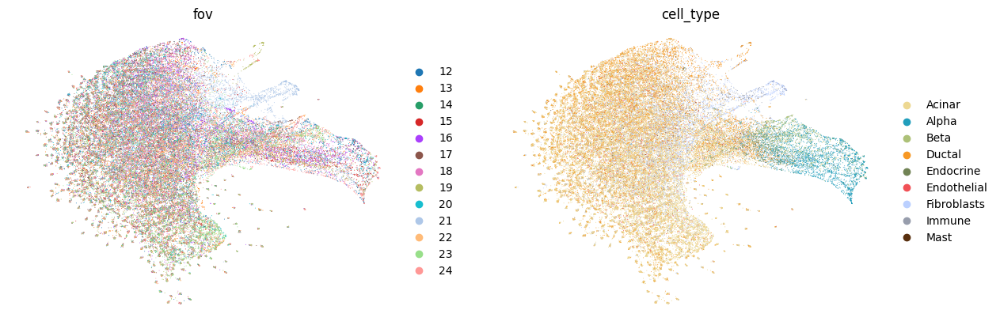

In [24]:
sc.pp.pca(niche_data_nd)
sc.pp.neighbors(niche_data_nd)
sc.tl.umap(niche_data_nd)
sc.pl.umap(niche_data_nd, color=['fov','cell_type'],frameon=False)

In [25]:
sc.tl.leiden(niche_data_nd, resolution=0.1, key_added='res_0.1') #, adjacency=fov.obsp["spatial_connectivities"])

/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


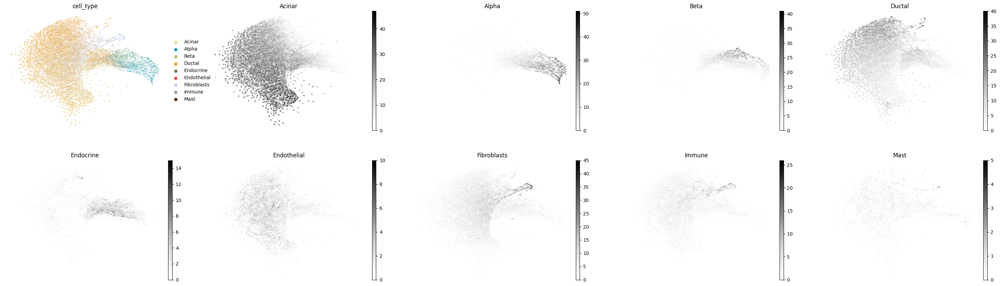

In [26]:
sc.pl.umap(niche_data_nd, color=['cell_type','Acinar', 'Alpha', 'Beta', 'Ductal', 'Endocrine', 'Endothelial',
       'Fibroblasts', 'Immune', 'Mast' ],ncols=5,frameon=False,cmap='Greys')

/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


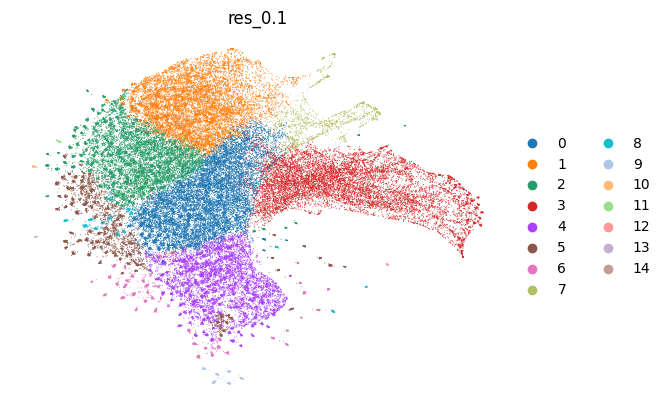

In [27]:
sc.pl.umap(niche_data_nd, color=['res_0.1'],ncols=4,frameon=False)

In [28]:
sc.tl.leiden(niche_data_nd, restrict_to=('res_0.1',['3']),resolution=0.1, key_added='res_0.1_'+str(0.1))

/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


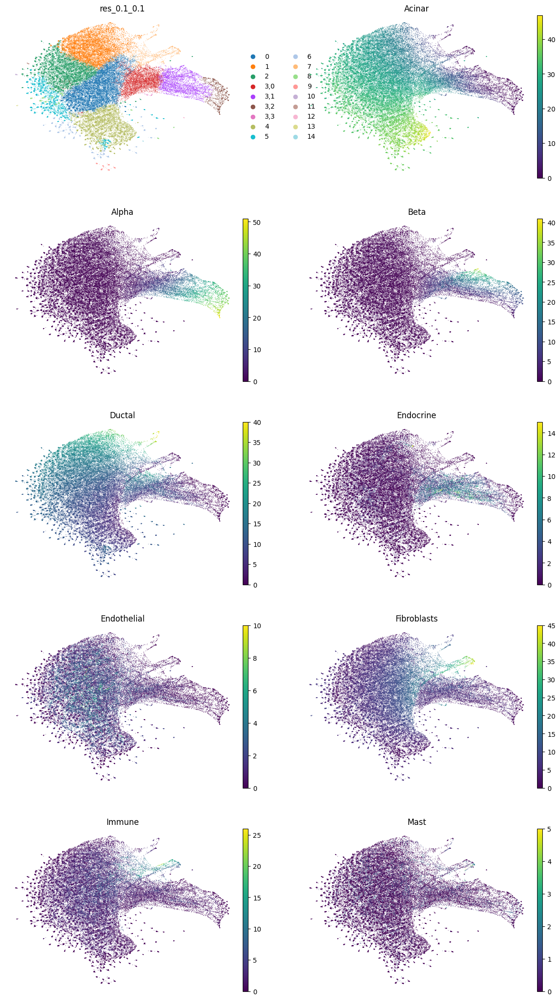

In [29]:
sc.pl.umap(niche_data_nd, color=['res_0.1_0.1','Acinar', 'Alpha', 'Beta', 'Ductal', 'Endocrine', 'Endothelial',
       'Fibroblasts', 'Immune', 'Mast'],ncols=2, frameon=False)

/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


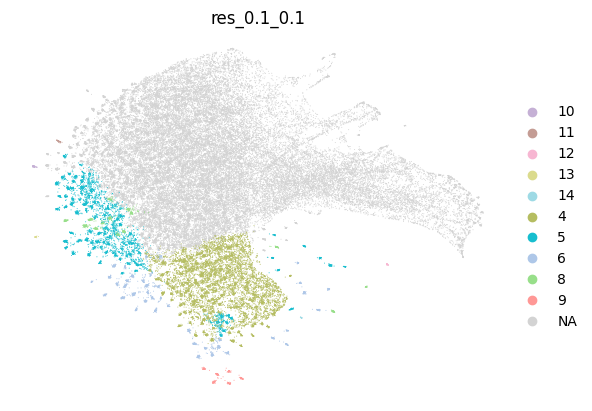

In [30]:
sc.pl.umap(niche_data_nd, color=['res_0.1_0.1'], groups=['4','5','6','8','9','10','11','12','13','14'],ncols=2, frameon=False)

In [31]:
niche_data_nd.obs['res_0.1_0.1'].cat.categories

Index(['0', '1', '2', '3,0', '3,1', '3,2', '3,3', '4', '5', '6', '7', '8', '9',
       '10', '11', '12', '13', '14'],
      dtype='object')

In [32]:
niche2annotation = {
    '0' : 'Acinar_Ductal',
    '1' : 'Ductal_enriched',
    '2' : 'Acinar_Ductal',
    '3,0' : 'Endocrine_Exocrine',
    '3,1' : 'Beta_enriched',
    '3,2' : 'Alpha_enriched',
    '3,3' : 'Endocrine_Exocrine',
    '4' : 'Acinar_enriched',
    '5' : 'Acinar_enriched',
    '6' : 'Acinar_enriched',
    '7' : 'Support_cells', 
    '8' : 'Acinar_enriched',
    '9' : 'Acinar_enriched',
    '10' : 'Acinar_enriched',
    '11' : 'Acinar_enriched',
    '12' : 'Acinar_enriched',
    '13' : 'Acinar_enriched',
    '14' : 'Acinar_enriched'
}

niche_data_nd.obs['niche_label'] = niche_data_nd.obs['res_0.1_0.1'].map(niche2annotation).astype('category')

niche_data_nd.obs['niche_label'].cat.reorder_categories(['Acinar_enriched','Acinar_Ductal','Ductal_enriched','Endocrine_Exocrine',
                                                      'Alpha_enriched','Beta_enriched','Support_cells'])

1_12         Acinar_Ductal
2_12         Acinar_Ductal
3_12       Ductal_enriched
4_12       Ductal_enriched
5_12       Ductal_enriched
                ...       
4724_24      Acinar_Ductal
4725_24      Acinar_Ductal
4726_24    Acinar_enriched
4727_24      Acinar_Ductal
4728_24    Acinar_enriched
Name: niche_label, Length: 61460, dtype: category
Categories (7, object): ['Acinar_enriched', 'Acinar_Ductal', 'Ductal_enriched', 'Endocrine_Exocrine', 'Alpha_enriched', 'Beta_enriched', 'Support_cells']

In [33]:
sc.tl.rank_genes_groups(niche_data_nd, 'niche_label', method='t-test')

/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/tools/_dendrogram.py:135: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_df = rep_df.groupby(level=0).mean()
/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  d = d.stack(level=1).reset_index()
/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the W

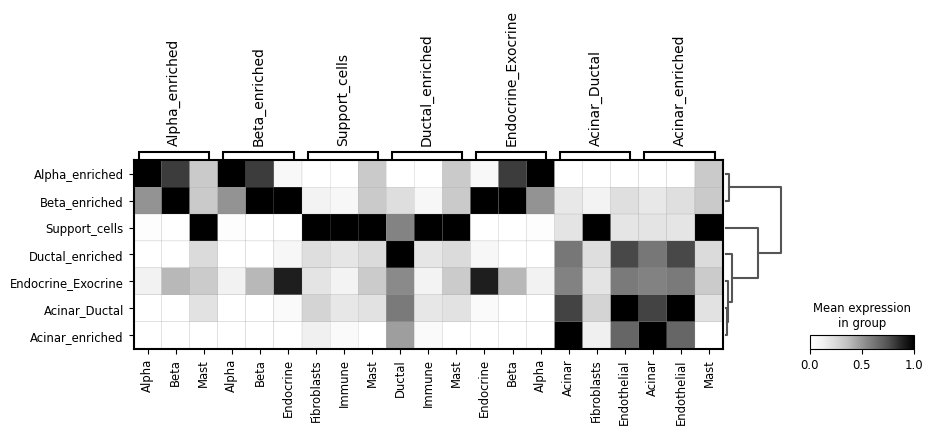

In [35]:
sc.tl.dendrogram(niche_data_nd, groupby='niche_label')
sc.pl.rank_genes_groups_matrixplot(
    niche_data_nd,
    n_genes=9,
    #values_to_plot="logfoldchanges",
    cmap='Greys',standard_scale='var'
)

### Niche analysis in healthy samples

In [36]:
adata_nd = adata[np.isin(adata.obs['condition'],['ND'])].copy()
adata_nd

AnnData object with n_obs × n_vars = 61460 × 979
    obs: 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.GCG', 'Max.GCG', 'Mean.CD3', 'Max.CD3', 'Mean.DAPI', 'Max.DAPI', 'cell_ID', 'condition', 'slide', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_NegPrb', 'log1p_total_counts_NegPrb', 'pct_counts_NegPrb', 'n_genes', 'cell_type_coarse'
    var: 'NegPrb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    uns: 'log1p', 'spatial', 'cell_type_coarse_colors', 'spatial_neighbors'
    obsm: 'spatial', 'spatial_fov'
    layers: 'counts'
    obsp: 'spatial_connectivities', 'spatial_distances'

In [37]:
niche_data_nd.obs.fov.unique()

['12', '13', '14', '15', '16', ..., '20', '21', '22', '23', '24']
Length: 13
Categories (13, object): ['12', '13', '14', '15', ..., '21', '22', '23', '24']

In [38]:
adata_nd.obs['niche_label'] = niche_data_nd.obs['niche_label']

In [39]:
adata_nd.obs['niche_label'].cat.categories

Index(['Acinar_Ductal', 'Acinar_enriched', 'Alpha_enriched', 'Beta_enriched',
       'Ductal_enriched', 'Endocrine_Exocrine', 'Support_cells'],
      dtype='object')

In [67]:
adata_nd.uns['niche_label_colors'] = [
    '#867A1D', #Acinar_Ductal
    '#edd892', #Acinar_enriched
    '#219ebc', #Alpha_enriched
    '#adc178', #Beta_enriched
    '#f79824', #Ductal_enriched
    '#718355', #Endocrine_Exocrine
    '#bbd0ff', #Support_cells
]

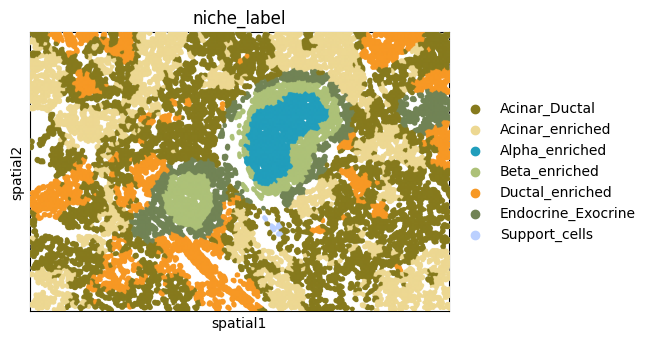

In [84]:
sq.pl.spatial_segment(
    adata_nd,
    library_id="12",
    seg_cell_id="cell_ID",
    library_key="fov",
    color=['niche_label'],
    size=60,
    img=False,cmap="RdYlBu_r",ncols=1
)

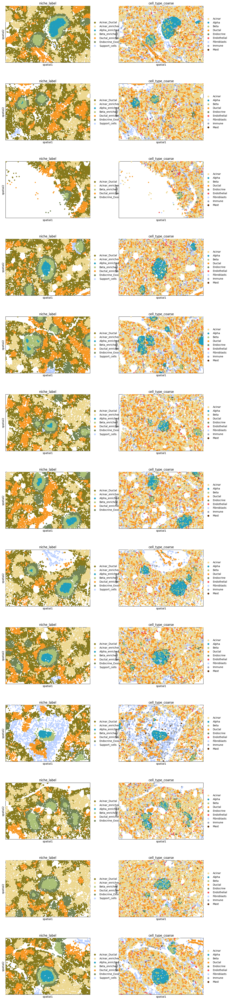

In [58]:
sq.pl.spatial_segment(
    adata_nd,
    #library_id="12",
    seg_cell_id="cell_ID",
    library_key="fov",
    color=['niche_label','cell_type_coarse'],
    size=60,
    img=False,cmap="RdYlBu_r",ncols=2
)

### Niche identification for T1D samples

In [42]:
# fov 5 doesn't have islets --> see initial data exploration --> exclude it from analysis 
niche_data_t1 = niche_data_t1[~niche_data_t1.obs.fov.isin(['5']),:].copy()
niche_data_t1

AnnData object with n_obs × n_vars = 43356 × 9
    obs: 'obs_names', 'fov', 'condition', 'cell_type'
    uns: 'cell_type_colors'

/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  col

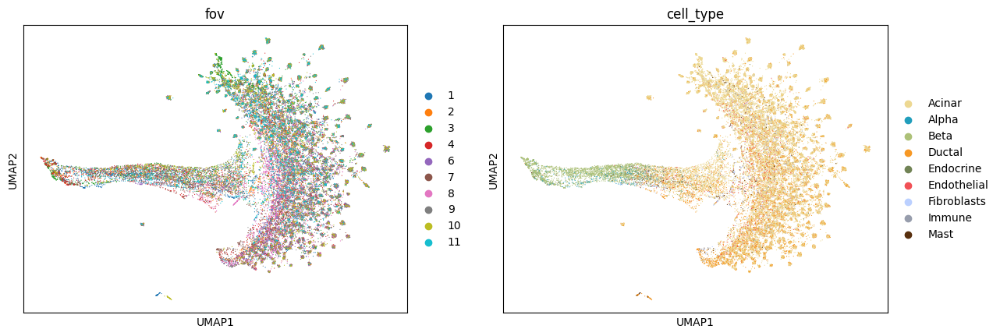

In [43]:
sc.pp.pca(niche_data_t1)
sc.pp.neighbors(niche_data_t1,n_neighbors=30)
sc.tl.umap(niche_data_t1)
sc.pl.umap(niche_data_t1, color=['fov','cell_type'])

In [45]:
sc.tl.leiden(niche_data_t1, resolution=0.1, key_added='res_0.1') #, adjacency=fov.obsp["spatial_connectivities"])

/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


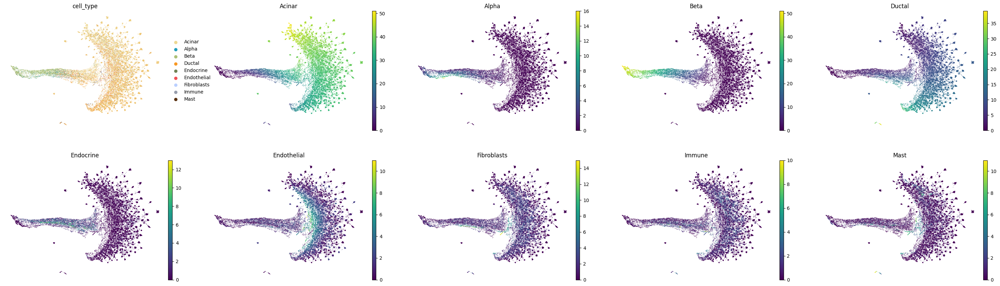

In [46]:
sc.pl.umap(niche_data_t1, color=['cell_type','Acinar', 'Alpha', 'Beta', 'Ductal', 'Endocrine', 'Endothelial',
       'Fibroblasts', 'Immune', 'Mast' ],ncols=5,frameon=False)

/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


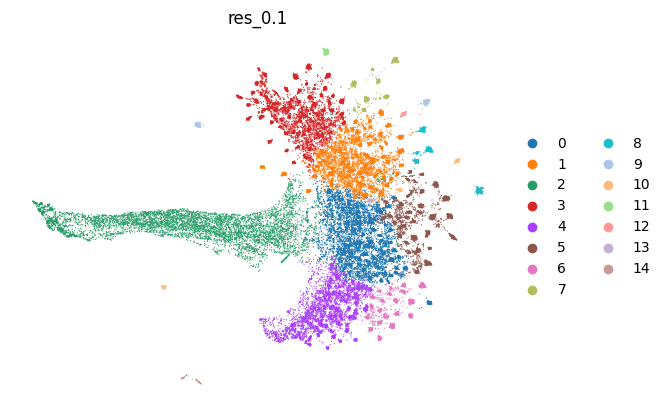

In [47]:
sc.pl.umap(niche_data_t1, color=['res_0.1'],
           ncols=4,frameon=False)

In [48]:
niche_data_t1.obs['res_0.1'].cat.categories

Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12',
       '13', '14'],
      dtype='object')

In [49]:
sc.tl.leiden(niche_data_t1, restrict_to=('res_0.1',['2']),resolution=0.1, key_added='res_0.1_'+str(0.1))

/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


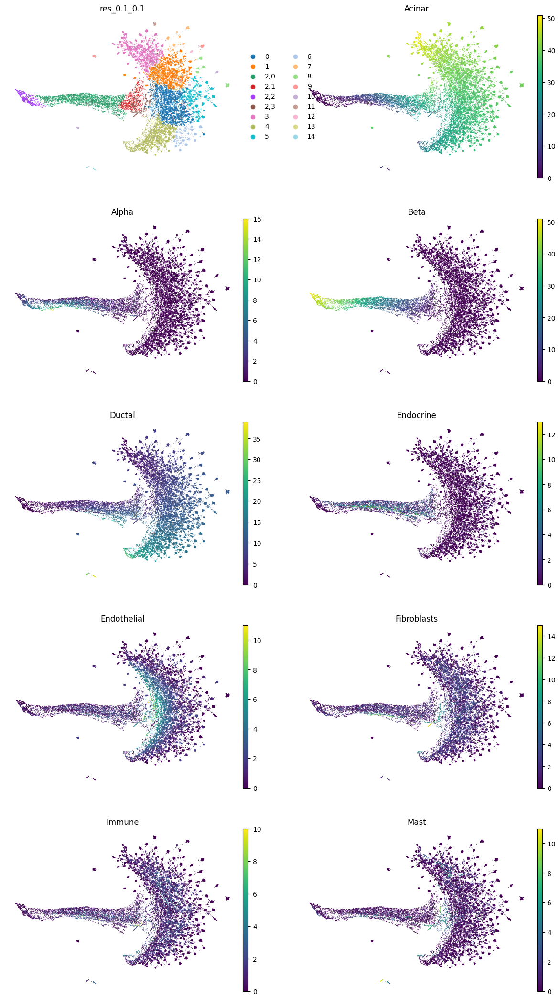

In [50]:
sc.pl.umap(niche_data_t1, color=['res_0.1_0.1','Acinar', 'Alpha', 'Beta', 'Ductal', 'Endocrine', 'Endothelial',
       'Fibroblasts', 'Immune', 'Mast'],ncols=2, frameon=False)

/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


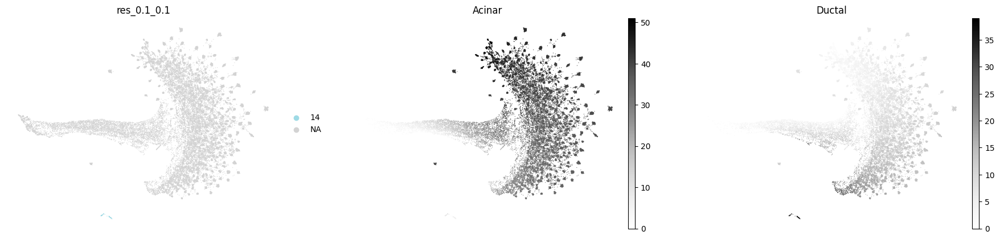

In [51]:
sc.pl.umap(niche_data_t1, color=['res_0.1_0.1','Acinar','Ductal'], ncols=4, groups=['14'], frameon=False,cmap='Greys')

In [52]:
niche_data_t1.obs['res_0.1_0.1'].cat.categories

Index(['0', '1', '2,0', '2,1', '2,2', '2,3', '3', '4', '5', '6', '7', '8', '9',
       '10', '11', '12', '13', '14'],
      dtype='object')

In [53]:
# note: Alpha enriched niche disapeared in this condition, while niches from acinar enriched increased. Also a new niche of mast enriched appeared
niche2annotation = {
    '0' : 'Acinar_Ductal',
    '1' : 'Acinar_enriched',
    '2,0' : 'Endocrine_Exocrine',
    '2,1' : 'Acinar_enriched',
    '2,2' : 'Beta_enriched',
    '2,3' : 'Mast_enriched',
    '3' : 'Acinar_enriched',
    '4' : 'Ductal_enriched',
    '5' : 'Acinar_enriched',
    '6' : 'Acinar_Ductal',
    '7' : 'Acinar_enriched', 
    '8' : 'Acinar_enriched',
    '9' : 'Acinar_enriched',
    '10' : 'Acinar_enriched',
    '11' : 'Acinar_enriched',
    '12' : 'Acinar_enriched',
    '13' : 'Acinar_enriched',
    '14' : 'Ductal_enriched'
}

niche_data_t1.obs['niche_label'] = niche_data_t1.obs['res_0.1_0.1'].map(niche2annotation).astype('category')

niche_data_t1.obs['niche_label'].cat.reorder_categories(['Acinar_enriched','Acinar_Ductal','Ductal_enriched','Endocrine_Exocrine',
                                                      'Beta_enriched','Mast_enriched'])

1_1        Acinar_enriched
2_1        Acinar_enriched
3_1        Acinar_enriched
4_1        Acinar_enriched
5_1        Acinar_enriched
                ...       
3630_11    Acinar_enriched
3631_11    Acinar_enriched
3632_11    Acinar_enriched
3633_11      Acinar_Ductal
3634_11    Acinar_enriched
Name: niche_label, Length: 43356, dtype: category
Categories (6, object): ['Acinar_enriched', 'Acinar_Ductal', 'Ductal_enriched', 'Endocrine_Exocrine', 'Beta_enriched', 'Mast_enriched']

In [54]:
sc.tl.rank_genes_groups(niche_data_t1, 'niche_label', method='t-test')

/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/tools/_dendrogram.py:135: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_df = rep_df.groupby(level=0).mean()
/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  d = d.stack(level=1).reset_index()
/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the W

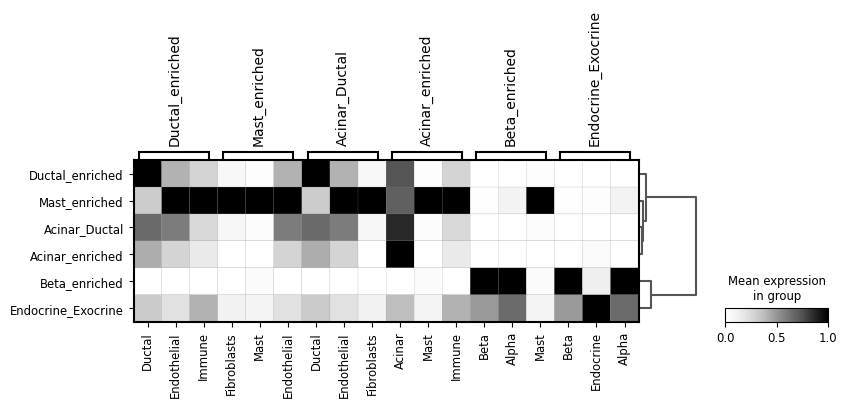

In [60]:
sc.tl.dendrogram(niche_data_t1, groupby='niche_label')
sc.pl.rank_genes_groups_matrixplot(
    niche_data_t1,
    n_genes=3,
    #values_to_plot="logfoldchanges",
    cmap='Greys',standard_scale='var'
)

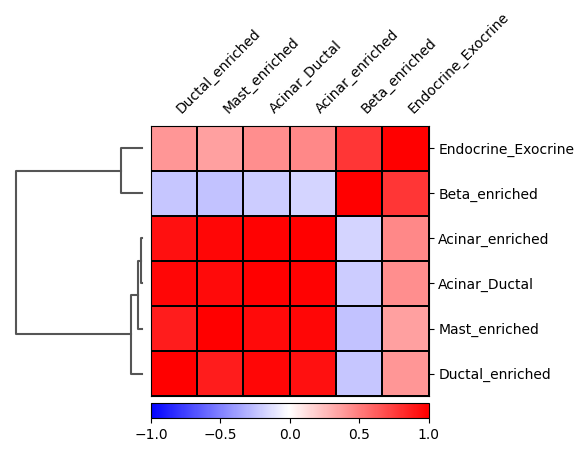

In [116]:
sc.pl.correlation_matrix(niche_data_t1, "niche_label")

### Niche analysis in T1D samples

In [61]:
adata_t1 = adata[np.isin(adata.obs['condition'],['T1D'])].copy()
adata_t1

AnnData object with n_obs × n_vars = 47251 × 979
    obs: 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.GCG', 'Max.GCG', 'Mean.CD3', 'Max.CD3', 'Mean.DAPI', 'Max.DAPI', 'cell_ID', 'condition', 'slide', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_NegPrb', 'log1p_total_counts_NegPrb', 'pct_counts_NegPrb', 'n_genes', 'cell_type_coarse'
    var: 'NegPrb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    uns: 'log1p', 'spatial', 'cell_type_coarse_colors', 'spatial_neighbors', 'niche_label_colors'
    obsm: 'spatial', 'spatial_fov'
    layers: 'counts'
    obsp: 'spatial_connectivities', 'spatial_distances'

In [62]:
# fov 5 doesn't have islets --> see initial data exploration --> exclude it from analysis 
adata_t1 = adata_t1[~adata_t1.obs.fov.isin(['5']),:].copy()
adata_t1

AnnData object with n_obs × n_vars = 43356 × 979
    obs: 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.GCG', 'Max.GCG', 'Mean.CD3', 'Max.CD3', 'Mean.DAPI', 'Max.DAPI', 'cell_ID', 'condition', 'slide', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_NegPrb', 'log1p_total_counts_NegPrb', 'pct_counts_NegPrb', 'n_genes', 'cell_type_coarse'
    var: 'NegPrb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    uns: 'log1p', 'spatial', 'cell_type_coarse_colors', 'spatial_neighbors', 'niche_label_colors'
    obsm: 'spatial', 'spatial_fov'
    layers: 'counts'
    obsp: 'spatial_connectivities', 'spatial_distances'

In [63]:
adata_t1.obs['niche_label'] = niche_data_t1.obs['niche_label']

In [64]:
adata_t1.obs['niche_label'].cat.categories

Index(['Acinar_Ductal', 'Acinar_enriched', 'Beta_enriched', 'Ductal_enriched',
       'Endocrine_Exocrine', 'Mast_enriched'],
      dtype='object')

In [66]:
adata_t1.uns['niche_label_colors'] = [
    '#867A1D', #Acinar_Ductal
    '#edd892', #Acinar_enriched
    #'#219ebc', #Alpha_enriched
    '#adc178', #Beta_enriched
    '#f79824', #Ductal_enriched
    '#718355', #Endocrine_Exocrine
    '#582f0e', #Support_cells
]

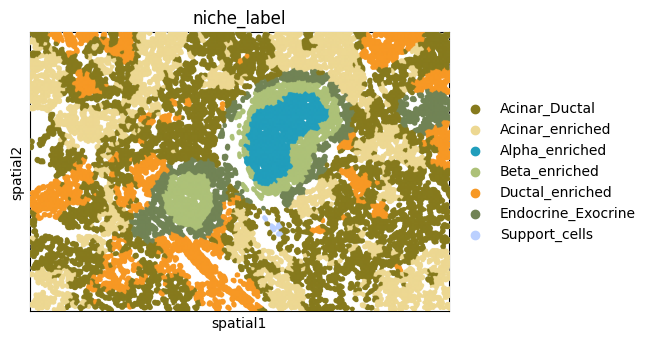

In [87]:
sq.pl.spatial_segment(
    adata_nd,
    library_id="12",
    seg_cell_id="cell_ID",
    library_key="fov",
    color=['niche_label'],
    size=60,
    img=False,cmap="RdYlBu_r",ncols=2
)

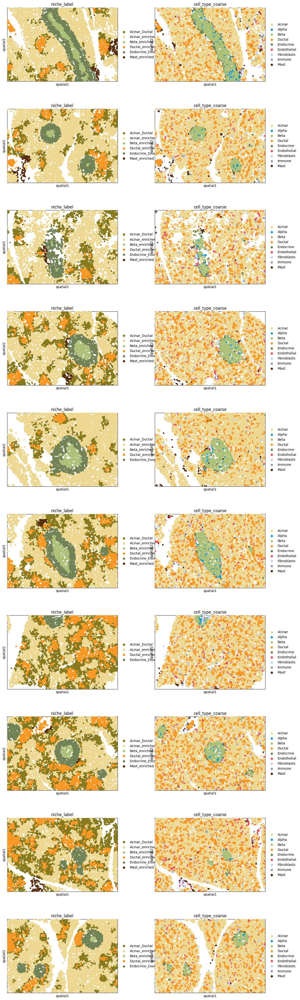

In [68]:
sq.pl.spatial_segment(
    adata_t1,
    #library_id="12",
    seg_cell_id="cell_ID",
    library_key="fov",
    color=['niche_label','cell_type_coarse'],
    size=60,
    img=False,cmap="RdYlBu_r",ncols=2
)

In [70]:
adata_nd, adata_t1

(AnnData object with n_obs × n_vars = 61460 × 979
     obs: 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.GCG', 'Max.GCG', 'Mean.CD3', 'Max.CD3', 'Mean.DAPI', 'Max.DAPI', 'cell_ID', 'condition', 'slide', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_NegPrb', 'log1p_total_counts_NegPrb', 'pct_counts_NegPrb', 'n_genes', 'cell_type_coarse', 'niche_label'
     var: 'NegPrb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
     uns: 'log1p', 'spatial', 'cell_type_coarse_colors', 'spatial_neighbors', 'niche_label_colors'
     obsm: 'spatial', 'spatial_fov'
     layers: 'counts'
     obsp: 'spatial_connectivities', 'spa

In [73]:
import anndata as ad
test  = ad.concat([adata_t1,adata_nd], join='inner',uns_merge='same',axis=0)
test.write('/lustre/groups/ml01/workspace/sara.jimenez/spatial_pancreas_data/preprocessed_data/data4downstream/S1_niche_label_annotated.h5ad')

In [75]:
test

AnnData object with n_obs × n_vars = 104816 × 979
    obs: 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.GCG', 'Max.GCG', 'Mean.CD3', 'Max.CD3', 'Mean.DAPI', 'Max.DAPI', 'cell_ID', 'condition', 'slide', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_NegPrb', 'log1p_total_counts_NegPrb', 'pct_counts_NegPrb', 'n_genes', 'cell_type_coarse', 'niche_label'
    uns: 'spatial', 'cell_type_coarse_colors', 'spatial_neighbors'
    obsm: 'spatial', 'spatial_fov'
    layers: 'counts'

In [77]:
sq.gr.spatial_neighbors(
    test,
    n_neighs=50,
    coord_type="generic",
    delaunay=True,
    library_key='fov'
)

/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/squidpy/pl/_color_utils.py:28: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  target.uns[color_key] = source.uns[color_key]


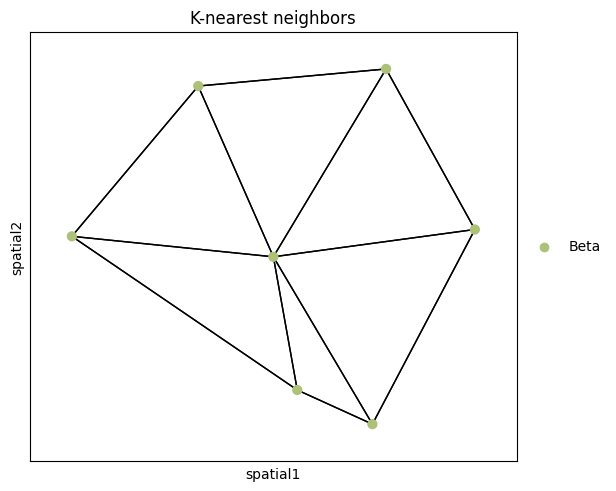

In [78]:
_, idx = test.obsp["spatial_connectivities"][420, :].nonzero()
idx = np.append(idx, 420)
sq.pl.spatial_scatter(
    test[idx,420],
    library_id = '12',
    color="cell_type_coarse",
    connectivity_key="spatial_connectivities",
    size=3,
    edges_width=1,
    edges_color="black",
    img=False,
    title="K-nearest neighbors"
)

In [79]:
sq.gr.nhood_enrichment(test,cluster_key='cell_type_coarse')

100%|██████████| 1000/1000 [00:08<00:00, 122.36/s]


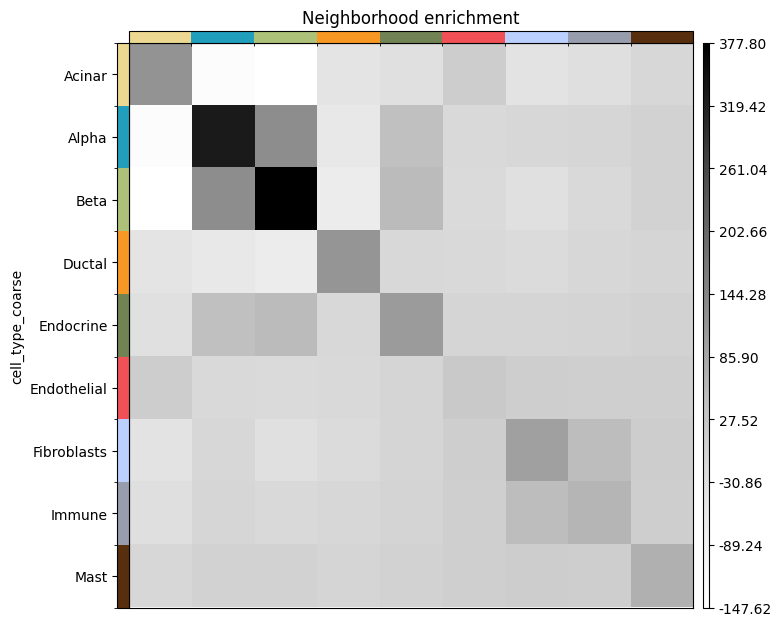

In [80]:
sq.pl.nhood_enrichment(test, cluster_key='cell_type_coarse',cmap='Greys')

In [81]:
sq.gr.centrality_scores(test, cluster_key="cell_type_coarse")

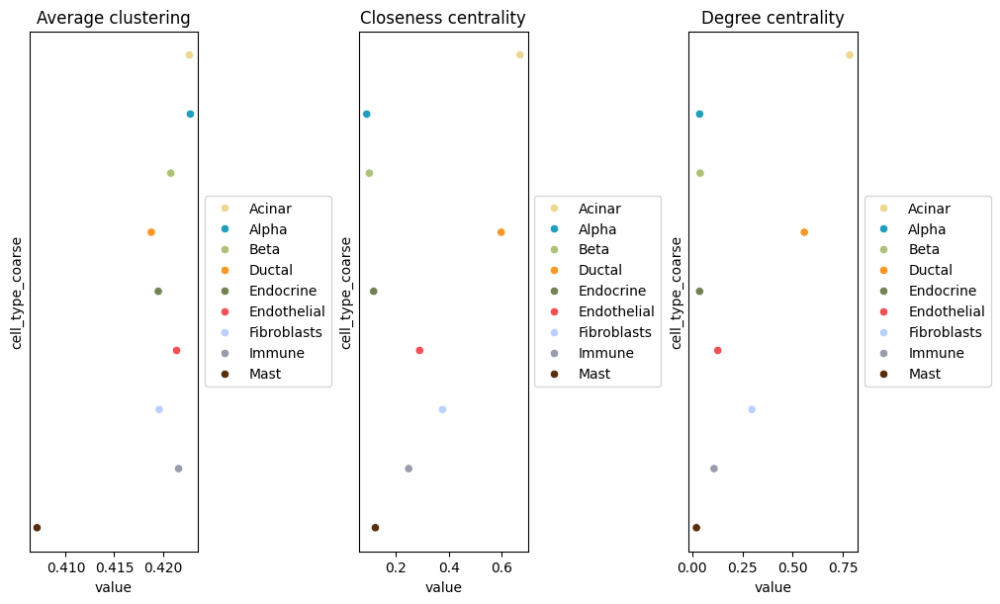

In [82]:
sq.pl.centrality_scores(test, cluster_key="cell_type_coarse", figsize=(10, 6))